<a href="https://colab.research.google.com/github/manahilnasim/Quanda-Chatbot/blob/main/group5pptx2video.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# @title Standard Setup
PROJECT = "/content/drive/MyDrive/NLP Final Project" # @param {type:"string"}

# mount google drive
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# handle paths
from pathlib import Path
DRIVE_PATH = Path("/content/drive/MyDrive/NLP Final Project")
PROJECT_PATH = DRIVE_PATH / PROJECT
PROJECT_PATH.mkdir(parents=True, exist_ok=True)

# symlink for faster filesystem traversal
SHORTCUT = Path("/content/drive/MyDrive/NLP Final Project")
if not SHORTCUT.exists():
    SHORTCUT.symlink_to(PROJECT_PATH)

Mounted at /content/drive


In [2]:
#-------------------------------------------------------------------------------
#                          INCREMENTAL BUILD                                   #
#-------------------------------------------------------------------------------
import json
import os
from pathlib import Path
import hashlib

hashes = {}

ASSETS_DIR = PROJECT_PATH / "assets"
ASSETS_DIR.mkdir(parents=True, exist_ok=True)

HASHES_FILE_PATH = ASSETS_DIR / 'hashes.json'
if HASHES_FILE_PATH.exists():
    with open(HASHES_FILE_PATH, 'r') as file:
        hashes = json.load(file)

def get_file_hash(file_path):
    """Calculate the MD5 hash of a file."""
    with open(file_path, "rb") as f:
        file_hash = hashlib.md5()
        chunk = f.read(8192)
        while chunk:
            file_hash.update(chunk)
            chunk = f.read(8192)
    return file_hash.hexdigest()

def has_changed(file_path):
    """Check if the file has changed since the last run."""
    file_path_str = str(file_path)
    current_hash = get_file_hash(file_path)

    if file_path_str in hashes and hashes[file_path_str] == current_hash:
        return False
    else:
        hashes[file_path_str] = current_hash
        return True


In [3]:
# @title REQUIRED: GO TO https://developers.google.com/workspace/guides/create-credentials TO GET CREDENTIALS IN THE FORM OF A JSON FILE
#-------------------------------------------------------------------------------
#                              UPLOAD TO:
# /content/drive/MyDrive/Colab Notebooks/aai520-project/google_credentials.json
#-------------------------------------------------------------------------------
GOOGLE_CREDENTIALS_PATH = PROJECT_PATH / "//content/drive/MyDrive/NLP Final Project/civil-celerity-402921-2f31a8d1bb31.json"
if not GOOGLE_CREDENTIALS_PATH.exists():
    raise FileNotFoundError(f"CREDENTIALS NOT FOUND: {GOOGLE_CREDENTIALS_PATH}")

# set environment variable for Google credentials
import os
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = str(GOOGLE_CREDENTIALS_PATH)

In [4]:
# @title UPLOAD POWERPOINT TO: `/content/drive/MyDrive/Colab Notebooks/aai520-project/POWERPOINT_FILE.pptx'
POWERPOINT_FILENAME = "/content/drive/MyDrive/NLP Final Project/Final Project Presentation-Team 5 (1).pptx" # @param {type:"string"}
#-------------------------------------------------------------------------------
#                              UPLOAD TO:
#  /content/drive/MyDrive/Colab Notebooks/aai520-project/POWERPOINT_FILE.pptx
#-------------------------------------------------------------------------------
!pip install \
  -qqq \
  --progress-bar=off \
  python-pptx

from pptx import Presentation

PRESENTATION_FILE_PATH = PROJECT_PATH / POWERPOINT_FILENAME
if not PRESENTATION_FILE_PATH.exists():
    raise FileNotFoundError(f"POWERPOINT NOT FOUND: {PRESENTATION_FILE_PATH}")

presentation = Presentation(str(PRESENTATION_FILE_PATH))
slides = presentation.slides

In [5]:
#-------------------------------------------------------------------------------
#                          SELECT VOICE HERE
#
#     preview voices at: https://cloud.google.com/text-to-speech/docs/voices
#
#-------------------------------------------------------------------------------
TTS_VOICE = "en-US-Neural2-J" # @param {type:"string"}

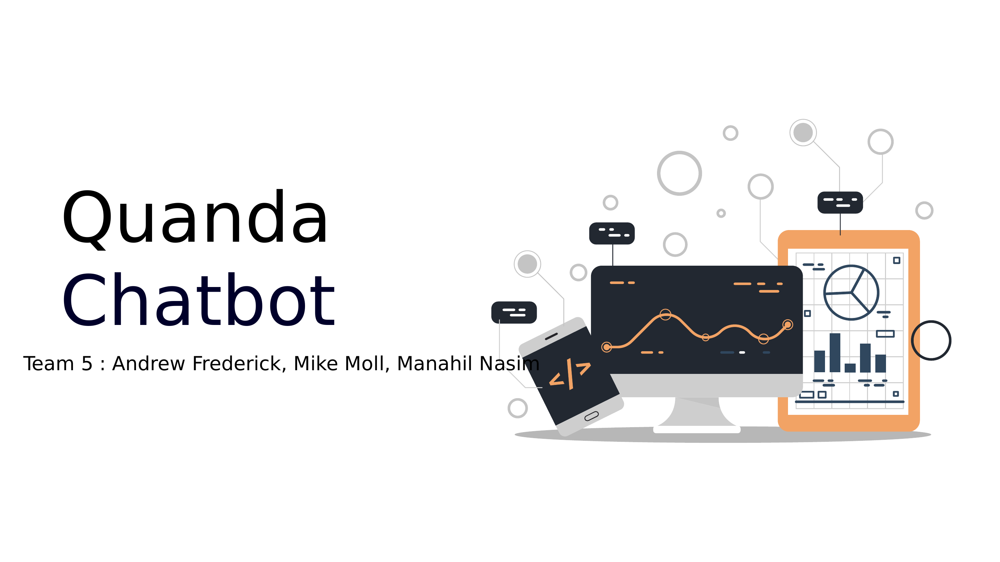

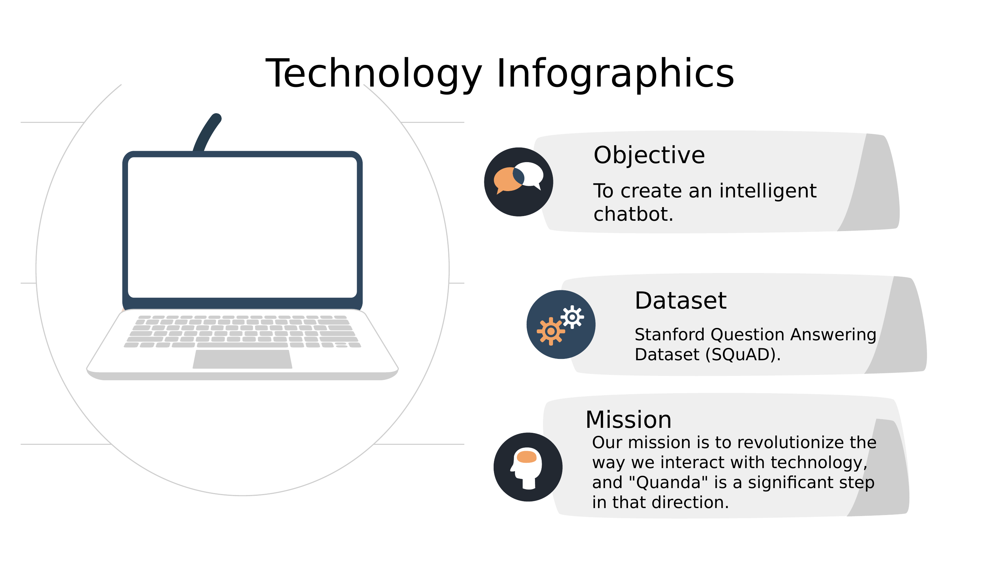

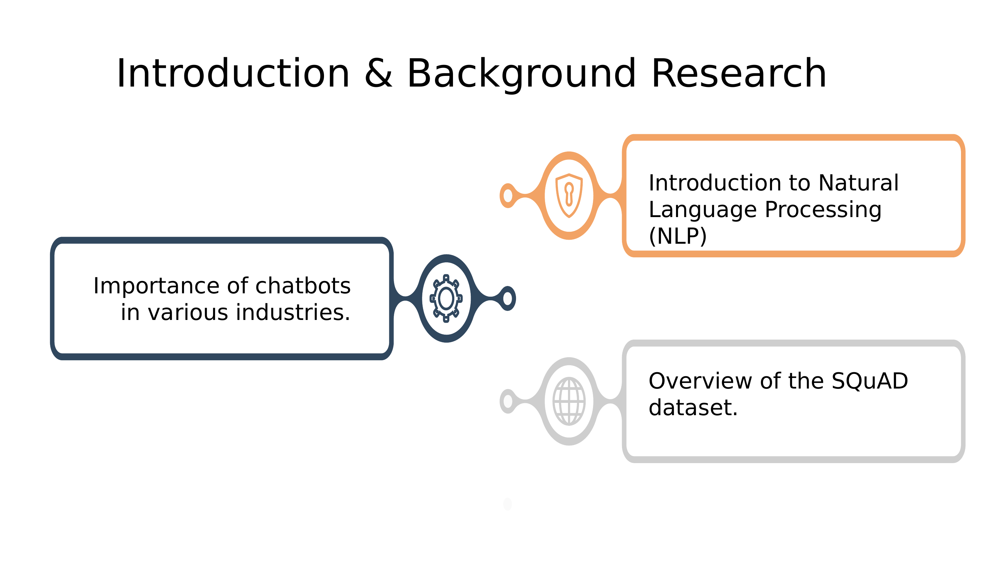

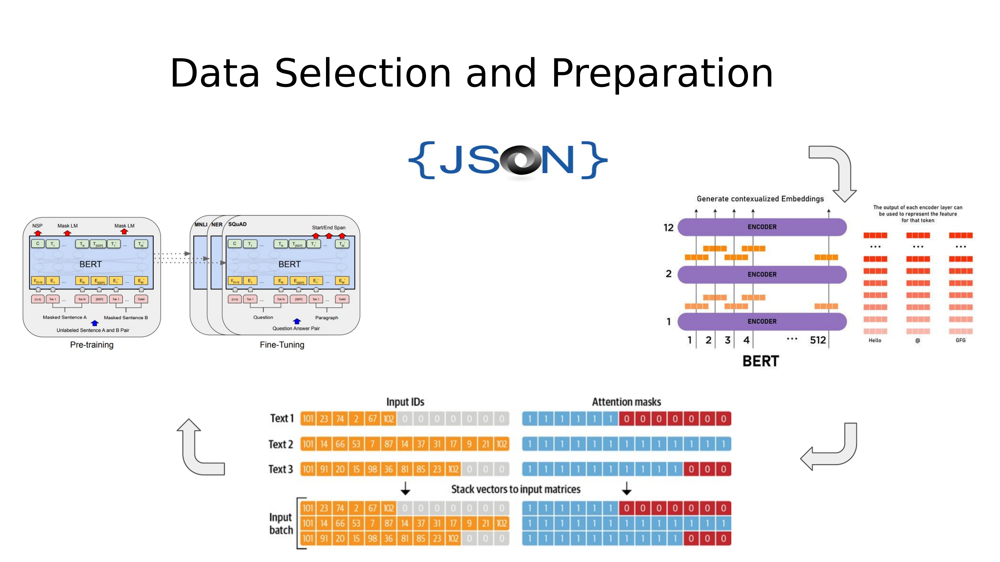

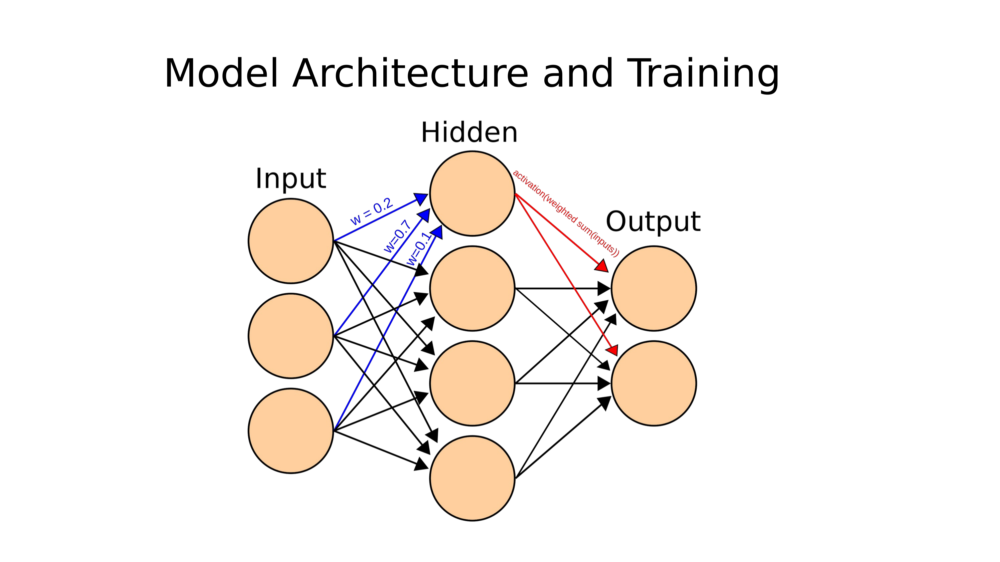

...

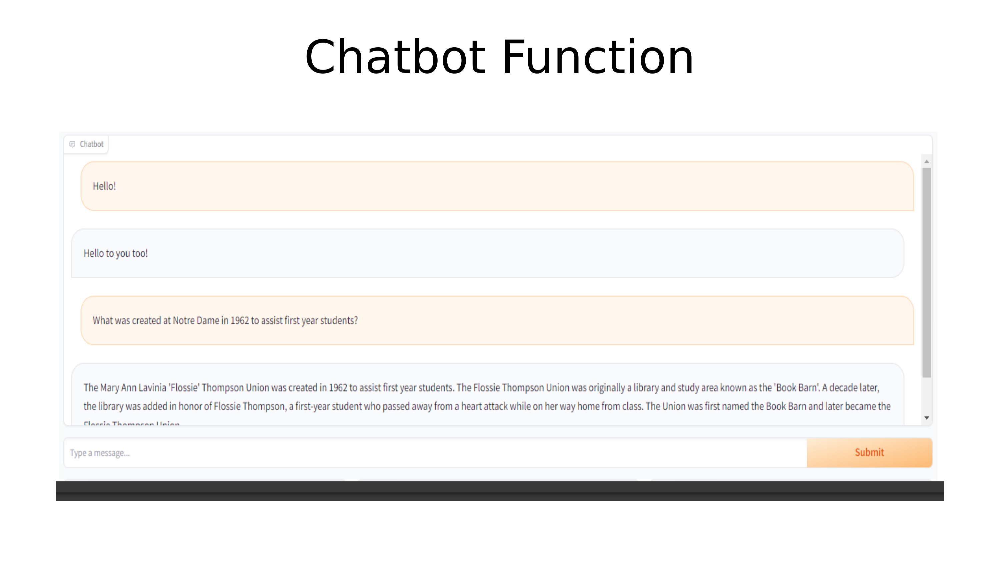

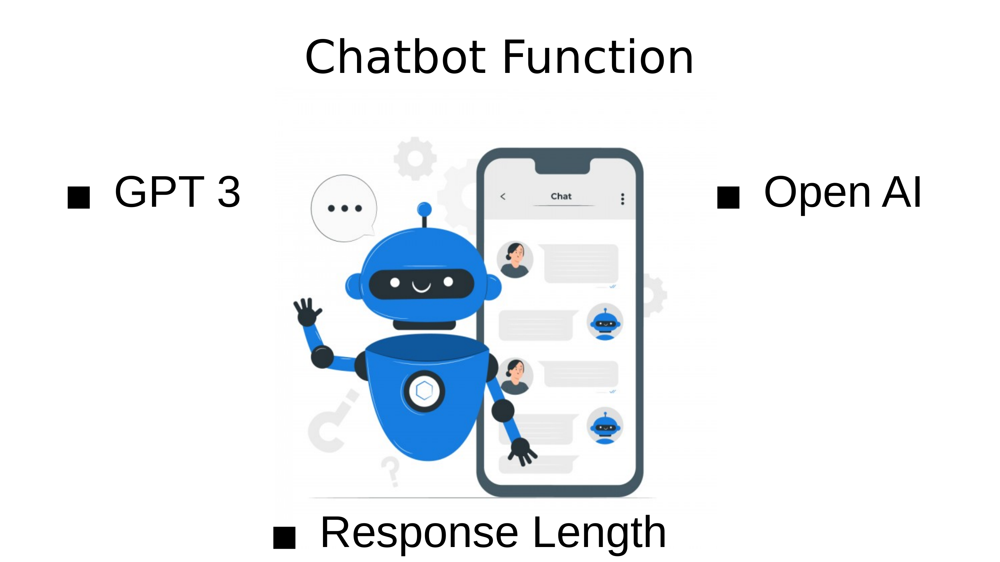

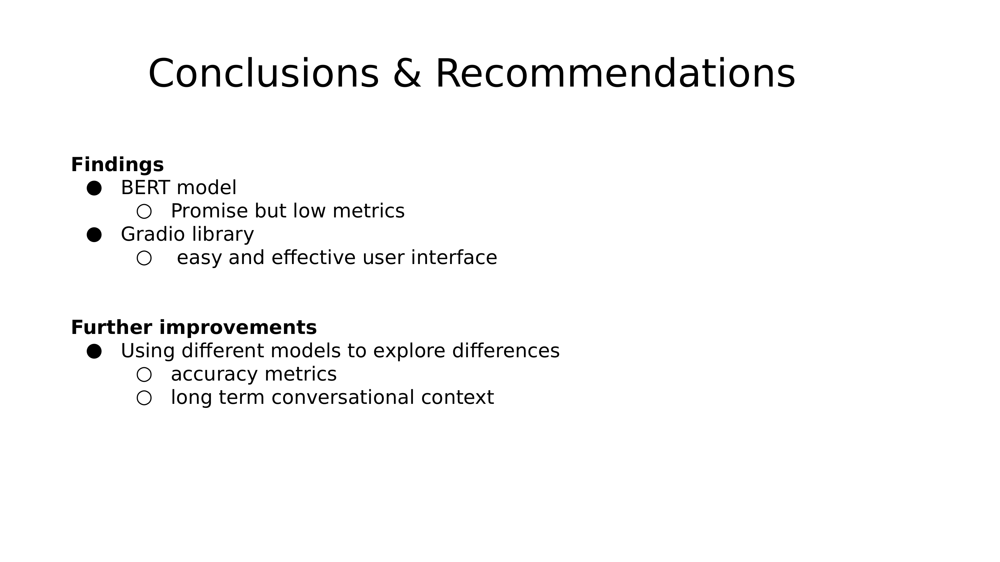

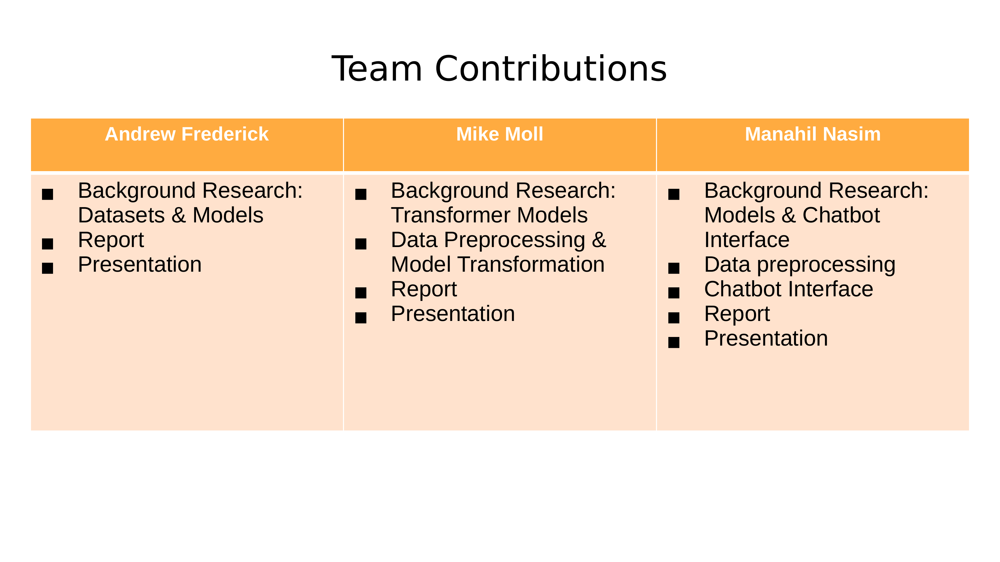

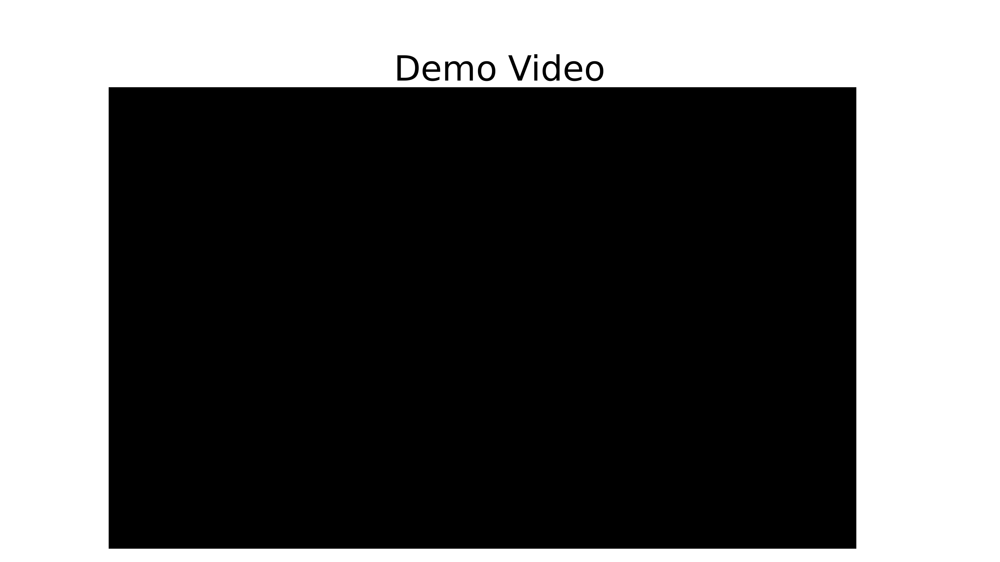

In [6]:
#-------------------------------------------------------------------------------
#
#                CONVERT POWERPOINT TO PNG IMAGES DIRECTLY
#
#-------------------------------------------------------------------------------
IMAGE_DPI = 300 # @param {type:"integer"}

# install libraries
!pip install \
  -qqq \
  --progress-bar=off \
  pdf2image

!sudo apt-get install -y libreoffice poppler-utils

import subprocess
from pdf2image import convert_from_path

# Convert PowerPoint to PDF
cmd = [
    "libreoffice",
    "--headless",
    "--convert-to",
    "pdf",
    str(PRESENTATION_FILE_PATH),
    "--outdir",
    str(ASSETS_DIR)
]
try:
    subprocess.run(cmd, check=True)
except subprocess.CalledProcessError as e:
    # Handle exceptions here
    print(e)
    print("An error occurred while converting the PowerPoint to PDF.")

# Determine the PDF file path
PDF_FILE_PATH = ASSETS_DIR / (Path(PRESENTATION_FILE_PATH).stem + ".pdf")
if not PDF_FILE_PATH.exists():
    raise ValueError("ERROR: PDF FILE NOT CREATED")

# Convert PDF to PNG Images
from pdf2image import convert_from_path
slide_images = convert_from_path(str(PDF_FILE_PATH), dpi=IMAGE_DPI)

image_files = []
for slide_index, image in enumerate(slide_images, start=1):
    slide_image_path = ASSETS_DIR / f"slide_image_{slide_index}.png"
    if not slide_image_path.exists() or has_changed(slide_image_path):
        image.save(slide_image_path, "PNG")
    image_files.append(slide_image_path)

# clear output before previewing images
from IPython.display import display, Image, clear_output
clear_output(wait=True)
for image_file in image_files:
    display(Image(filename=str(image_file), width=320, height=180))

In [7]:
#-------------------------------------------------------------------------------
#
#               PREVIEW VOICEOVER CLIPS AND POWERPOINT NOTES
#
#-------------------------------------------------------------------------------
!pip install \
  -qqq \
  --progress-bar=off \
  google-cloud-texttospeech

from google.cloud import texttospeech as tts
from IPython.display import Audio, display
from pptx import Presentation

# helper function to break text into lines of a certain length
def break_text_at_limit(text, char_limit=80):
    words = text.split()
    lines = []
    current_line = []

    for word in words:
        if len(" ".join(current_line + [word])) <= char_limit:
            current_line.append(word)
        else:
            lines.append(" ".join(current_line))
            current_line = [word]
    if current_line:
        lines.append(" ".join(current_line))

    return "\n".join(lines)

# load the PowerPoint presentation
presentation = Presentation(PRESENTATION_FILE_PATH)

# extract notes from each slide
notes_texts = []
for slide in presentation.slides:
    if slide.notes_slide:
        notes_text = slide.notes_slide.notes_text_frame.text
        notes_texts.append(notes_text)

# initialize Google TTS client
tts_client = tts.TextToSpeechClient()
TTS_AUDIO_ENCODING = tts.AudioEncoding.LINEAR16

# convert each note to audio
audio_files = []
for slide_index, notes_text in enumerate(notes_texts, start=1):
    audio_output_path = ASSETS_DIR / f"narration_{slide_index}.wav"
    if not audio_output_path.exists() or has_changed(audio_output_path):
        synthesis_response = tts_client.synthesize_speech(
            input=tts.SynthesisInput(text=notes_text),
            voice=tts.VoiceSelectionParams(language_code='en-US', name=TTS_VOICE),
            audio_config=tts.AudioConfig(audio_encoding=TTS_AUDIO_ENCODING),
        )
        with audio_output_path.open("wb") as audio_file:
            audio_file.write(synthesis_response.audio_content)
    audio_files.append(audio_output_path)

# preview generated audio voiceovers with the corresponding formatted text
for index, (audio_file, notes_text) in enumerate(zip(audio_files, notes_texts), start=1):
    formatted_note = break_text_at_limit(notes_text)
    print(f"Slide {index}")
    print("--------------------------------------------------------------------------------")
    print(formatted_note)
    print("\n")
    display(Audio(filename=str(audio_file)))
    print("\n")


Slide 1
--------------------------------------------------------------------------------
Hello, today we are going to explore the exciting world of Natural Language
processing and creating generative artificial intelligence chatbots. Team 5 is
comprised of Andrew Frederick, Mike Moll, and Manahil Nasim. This presentation
is a part of AAI 520 at the University of San Diego.






Slide 2
--------------------------------------------------------------------------------
We’re excited to take you on a journey through the development of our chatbot
project, "Quanda." This presentation outlines our process and demonstrates the
potential of leveraging the Stanford Question Answering Dataset (SQuAD) to
create an intelligent and effective chatbot. Our mission is to revolutionize the
way we interact with technology, and "Quanda" is a significant step in that
direction.






Slide 3
--------------------------------------------------------------------------------
Our project is rooted in Natural Language Processing (NLP), a field that has
transformed the way we interact with technology. Chatbots, in particular, are
making waves in various industries, from customer service to search engines. The
SQuAD dataset, derived from Wikipedia, serves as a robust resource for our
chatbot's development. Furthermore, we harnessed the power of transformers, such
as BertTokenizer, to excel in NLP tasks.






Slide 4
--------------------------------------------------------------------------------
The data selection and preparation process for our BERT-based Question Answering
system. We start by loading our training and development datasets from JSON
files. This data is then tokenized using BERT's specialized tokenizer, ensuring
it's in a format suitable for our deep learning model. One of the challenges in
tokenization is managing longer texts that don't fit within BERT's input limit.
We address this by handling token overflows and adjusting the positions of our
answers accordingly. Once our data is prepared, we set up our training
environment. This includes initializing our BERT model specifically designed for
question answering, and setting up our training loop. Throughout this process,
the emphasis is on careful and precise data handling to ensure our model is
trained on high-quality, well-prepared data.This is not an easy process, and
there is still room for improvement when it comes



Slide 5
--------------------------------------------------------------------------------
In this project, we leverage the power of BERT, a transformative architecture in
the NLP domain. Our BERT model is fine-tuned specifically for Question Answering
tasks. The model takes in tokenized questions and their corresponding context.
Through its deep neural layers, it predicts the start and end positions of
potential answers within the context. Training this model is an iterative
process. In each loop, the model's predictions are optimized using a defined
loss function. We also ensure that we save model checkpoints at regular
intervals, allowing us to revert or continue from specific points in the
training. This architecture and training process equips our model to accurately
locate answers to a wide range of questions.






Slide 6
--------------------------------------------------------------------------------
After fine tuning the model on the training model, the output accuracy was
tested on a validation set. The accuracy of the chatbot answers compared to the
ground truth answers was measured in F1 score and exact match score. The final
F1 score was 0.166, while the exact match was 0.12. While these scores are
certainly low, traditional metrics may not be an accurate depiction of a
chatbots success rate, as similar answers may still be correct and
understandable by the human user Low metrics suggest that while BERT serves as a
powerful model for a wide range of NLP tasks, question answering remains a
challenging problem, and further research is needed to achieve higher accuracy.






Slide 7
--------------------------------------------------------------------------------
To make 'Quanda' user-friendly, we've harnessed the power of Gradio, an
interactive interface creation library. It's what you see when you interact with
'Quanda.' The interface consists of two text boxes, one for user input and the
other for chatbot responses. Additionally, we've taken it a step further by
including a third text box displaying the conversation history. This feature
ensures that users have full context of the ongoing conversation.






Slide 8
--------------------------------------------------------------------------------
In this slide, we'll take a closer look at how the 'Quanda' chatbot function
operates At the heart of 'Quanda' lies the chat history. It's like the memory of
our chatbot. When a user interacts with 'Quanda,' their inputs are recorded and
appended to the chat history. This is crucial for the chatbot to understand the
context of the conversation. The chatbot function follows a clear sequence of
operations. First, the user's input is added to the chat history, building
context. Then, GPT-3 is summoned to generate a response. It's important to note
that the chat history, which includes both user inputs and chatbot responses,
serves as the prompt for generating meaningful responses. Additionally, we can
control the length of responses using the 'max_tokens' parameter.






Slide 9
--------------------------------------------------------------------------------
At the core of 'Quanda' lies GPT-3, a generative pre-trained transformer
developed by OpenAI. GPT-3 is designed to understand human language, generate
text, and make context-aware responses. This technology is what enables 'Quanda'
to converse with users in a human-like manner The integration of the OpenAI API
allows 'Quanda' to access GPT-3's capabilities seamlessly. It's like 'Quanda' is
connected to a powerful language understanding engine, ready to assist with a
wide range of user queries Furthermore we've added the 'MAX_TOKENS' parameter
within the Gradio interface to give us control over the length of responses.
This parameter enables us to fine-tune how concise or detailed the chatbot's
replies should be.






Slide 10
--------------------------------------------------------------------------------
From working with the BERT and Quanda architectures we learned many lessons
about the creation and limitations of Chatbots. While BERT, with its
bidirectional capabilities and pre-trained knowledge, provided a strong
foundation, achieving high accuracy in question answering remains a complex
problem. The creation of "Quanda" demonstrates the feasibility of developing
chatbots using advanced NLP models that are fine tuned to specific needs with
structured datasets. Using the Gradio library was a simple process to create a
high quality interface which was able to present the functionality of the model
in a pleasing way For future work to improve the project, we would target higher
performance and better conversational context tracking by exploring different
models such as T5 or XLnet. One limitation on our work was the computational
complexity, so a lighter weight version of a model like DistilBER



Slide 11
--------------------------------------------------------------------------------
Team contributions: Andrew Frederick: Background Research on Datasets & Models,
Final Report, and Presentation. Mike Moll: Background Research: Transformer
models, Data Preprocessing & Model Transformation, Final Report, Code for
presentation, and Presentation Manahil Nasim: background research: models and
chatbot interface, data preprocessing, chatbot interface, final report, and
presentation.






Slide 12
--------------------------------------------------------------------------------
In this video you can see a brief demonstration of our generative chatbot at
work. We have successfully incorporated a front end graphical user interface.
You can see the chatbot is successfully answering questions.




In [8]:
#-------------------------------------------------------------------------------
#
#                          CREATE VIDEO CLIPS
#
#-------------------------------------------------------------------------------
!pip install \
  -qqq \
  --progress-bar=off \
  moviepy

import pickle

import numpy as np
from IPython.display import clear_output
from moviepy.audio.AudioClip import AudioArrayClip
from moviepy.editor import *

HASH_FILE_PATH = ASSETS_DIR / "file_hashes.pickle"
AUDIO_FRAME_RATE = 44100
IMAGE_DPI = 300
SHORT_SILENCE = np.zeros((1, 2))

# make videoclips from each slide
videoclips = []
for slide_index, (image_path, audio_path) in enumerate(zip(image_files, audio_files), start=1):
    output_path = ASSETS_DIR / f"slide_video_{slide_index}.mp4"
    # check if videoclip has already rendered
    if not output_path.exists() or has_changed(output_path) or has_changed(image_path) or has_changed(audio_path):
        # create a sound clip of silence to add pauses between slides
        silence_clip = AudioArrayClip(SHORT_SILENCE, fps=AUDIO_FRAME_RATE).set_duration(0.5)
        # load the voiceover audio
        voiceover_audio = AudioFileClip(str(audio_path))
        # add silence at the start and end of each voiceover audio
        combined_audio = concatenate_audioclips([silence_clip, voiceover_audio, silence_clip])
        # load slide image as a video frame
        video_frame = ImageClip(str(image_path), duration=combined_audio.duration)
        # combine audio and frame to create a video clip
        videoclip = video_frame.set_audio(combined_audio)
        # save videoclip to file
        videoclip.write_videofile(str(output_path), fps=24, verbose=False, logger=None)
        # immediately calculate and update hash
        new_file_hash = get_file_hash(output_path)
        hashes[output_path] = new_file_hash

    # append the video file path to videoclips list
    videoclips.append(str(output_path))

    # print(f"PREVIEW VIDEOCLIP: {slide_index}/{len(image_files)}", end='\r')
    # video_file = f"slide_video_{slide_index}.mp4"
    # video_clip = VideoFileClip(str(ASSETS_DIR / video_file))
    # display(video_clip.ipython_display(width=300, maxduration=1000, quiet=True))

# save updated hashes to identify changes
hashes_str_keys = {str(key): value for key, value in hashes.items()}
with open(HASHES_FILE_PATH, 'w') as file:
    json.dump(hashes_str_keys, file)

In [9]:
# -----------------------------------------------------------------------------
#                 COMBINE ALL VIDEO CLIPS INTO ONE VIDEO
# -----------------------------------------------------------------------------
# Install necessary packages
!pip install moviepy
!pip install imageio-ffmpeg

from moviepy.editor import VideoFileClip, concatenate_videoclips

fps = 24

# load video files as VideoClip objects
slide_videos = [VideoFileClip(str(video_path)) for video_path in videoclips]

# set the fps for each video clip
slide_videos_fps_fixed = [video.set_fps(fps) for video in slide_videos]

# concatenate all the slide videos
final_presentation_video = concatenate_videoclips(slide_videos_fps_fixed, method="compose")

# define the output video path
OUTPUT_VIDEO_PATH = ASSETS_DIR / f"{PRESENTATION_FILE_PATH.stem}_final.mp4"

# write the final concatenated video to a file
OUTPUT_VIDEO_PATH.parent.mkdir(exist_ok=True)
final_presentation_video.write_videofile(str(OUTPUT_VIDEO_PATH), fps=fps)


# free memory
for clip in slide_videos:
    clip.close()
final_presentation_video.close()

Moviepy - Building video /content/drive/MyDrive/NLP Final Project/assets/Final Project Presentation-Team 5 (1)_final.mp4.
MoviePy - Writing audio in Final Project Presentation-Team 5 (1)_finalTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video /content/drive/MyDrive/NLP Final Project/assets/Final Project Presentation-Team 5 (1)_final.mp4



t:   5%|▍         | 515/11252 [00:45<15:21, 11.66it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file /content/drive/MyDrive/NLP Final Project/assets/slide_video_1.mp4, 15192000 bytes wanted but 0 bytes read,at frame 515/516, at time 21.46/21.47 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

t:  16%|█▋        | 1853/11252 [02:44<13:29, 11.61it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/moviepy/video/io/ffmpeg_reader.py:123: UserWarning: Warning: in file /content/drive/MyDrive/NLP Final Project/assets/slide_video_3.mp4, 15192000 bytes wanted but 0 bytes read,at frame 742/743, at time 30.92/30.93 sec. Using the last valid frame instead.
  warnings.warn("Warning: in file %s, "%(self.filename)+

t:  40%|███▉      | 4449/11252 [06:35<09:57, 11.38it/s, now=None]WARNING:py.warnings:/usr/local/lib/python3.10/dist-packages/mo

Moviepy - Done !
Moviepy - video ready /content/drive/MyDrive/NLP Final Project/assets/Final Project Presentation-Team 5 (1)_final.mp4
